In [2]:
import pandas as pd
import numpy as np 
import matplotlib.pyplot as plt 
%matplotlib inline
plt.style.use('ggplot')
import dateutil.parser
import datetime

import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42

In [22]:
import math

# Read in Depository Institution data for all available years, clean up a bit. 

In [3]:
def read_and_clean(filen):
    
    df = pd.read_csv(str(filen))
    
    df = df[ ~(df['Year Month'].str.contains("Total"))]
    df['year'] = df['Year Month'].str.extract(r"(\d+) \w+")
    df['month'] = df['Year Month'].str.extract(r"\d+ (\w+)")
    
    df['date'] = pd.to_datetime(df['Year Month'], format='%Y %B')
    df.index = df['date']
    
    df = df[ ~(df['State'].str.contains("Total"))]
    df = df[ ~(df['Countym'].str.contains("Total"))]
    df = df[ ~(df['Industry'].str.contains("Total"))]
    df = df[ ~(df['Suspicious Activity'].str.contains("Total"))]
    df = df[ ~(df['Count'].str.contains("Total"))]
    
    df['Count'] = df['Count'].str.replace(',','')
    df['Count'] = df['Count'].astype(int)
    
    df['county'] = df['Countym'].str.extract(r"(.*), \w+")
    df['combined'] = df['county'] + ", " + df['State']

    
    return df

In [4]:
data = {}

In [5]:
data['2012'] = read_and_clean("DI-2012.csv")
data['2013'] = read_and_clean("DI-2013.csv")
data['2014'] = read_and_clean("DI-2014.csv")
data['2015'] = read_and_clean("DI-2015.csv")
data['2016'] = read_and_clean("DI-2016.csv")
data['2017'] = read_and_clean("DI-2017.csv")

/Users/rashidakamal/.virtualenvs/work/lib/python3.6/site-packages/ipykernel_launcher.py:6: FutureWarning: currently extract(expand=None) means expand=False (return Index/Series/DataFrame) but in a future version of pandas this will be changed to expand=True (return DataFrame)
  
/Users/rashidakamal/.virtualenvs/work/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: currently extract(expand=None) means expand=False (return Index/Series/DataFrame) but in a future version of pandas this will be changed to expand=True (return DataFrame)
  import sys
/Users/rashidakamal/.virtualenvs/work/lib/python3.6/site-packages/ipykernel_launcher.py:21: FutureWarning: currently extract(expand=None) means expand=False (return Index/Series/DataFrame) but in a future version of pandas this will be changed to expand=True (return DataFrame)


# Functions for spitting out suspicious activities small multiples

In [50]:
data['2012'].head()

,Year Month,State,Countym,Industry,Suspicious Activity,Count,year,month,date,county,combined
date,,,,,,,,,,,
2012-03-01,2012 March,Connecticut,"Fairfield County, CT",Depository Institution,Identity Theft,1,2012,March,2012-03-01,Fairfield County,"Fairfield County, Connecticut"
2012-03-01,2012 March,Connecticut,"Fairfield County, CT",Depository Institution,Wire Transfer,1,2012,March,2012-03-01,Fairfield County,"Fairfield County, Connecticut"
2012-03-01,2012 March,Delaware,"Kent County, DE",Depository Institution,Other Money Laundering,1,2012,March,2012-03-01,Kent County,"Kent County, Delaware"
2012-03-01,2012 March,Georgia,"Union County, GA",Depository Institution,Wire Transfer,1,2012,March,2012-03-01,Union County,"Union County, Georgia"
2012-03-01,2012 March,Illinois,"Cook County, IL",Depository Institution,Multiple Transactions Below Ctr Threshold,1,2012,March,2012-03-01,Cook County,"Cook County, Illinois"


In [48]:
states_dict = {
        'AK': 'Alaska',
        'AL': 'Alabama',
        'AR': 'Arkansas',
        'AS': 'American Samoa',
        'AZ': 'Arizona',
        'CA': 'California',
        'CO': 'Colorado',
        'CT': 'Connecticut',
        'DC': 'District of Columbia',
        'DE': 'Delaware',
        'FL': 'Florida',
        'GA': 'Georgia',
        'GU': 'Guam',
        'HI': 'Hawaii',
        'IA': 'Iowa',
        'ID': 'Idaho',
        'IL': 'Illinois',
        'IN': 'Indiana',
        'KS': 'Kansas',
        'KY': 'Kentucky',
        'LA': 'Louisiana',
        'MA': 'Massachusetts',
        'MD': 'Maryland',
        'ME': 'Maine',
        'MI': 'Michigan',
        'MN': 'Minnesota',
        'MO': 'Missouri',
        'MP': 'Northern Mariana Islands',
        'MS': 'Mississippi',
        'MT': 'Montana',
        'NA': 'National',
        'NC': 'North Carolina',
        'ND': 'North Dakota',
        'NE': 'Nebraska',
        'NH': 'New Hampshire',
        'NJ': 'New Jersey',
        'NM': 'New Mexico',
        'NV': 'Nevada',
        'NY': 'New York',
        'OH': 'Ohio',
        'OK': 'Oklahoma',
        'OR': 'Oregon',
        'PA': 'Pennsylvania',
        'PR': 'Puerto Rico',
        'RI': 'Rhode Island',
        'SC': 'South Carolina',
        'SD': 'South Dakota',
        'TN': 'Tennessee',
        'TX': 'Texas',
        'UT': 'Utah',
        'VA': 'Virginia',
        'VI': 'Virgin Islands',
        'VT': 'Vermont',
        'WA': 'Washington',
        'WI': 'Wisconsin',
        'WV': 'West Virginia',
        'WY': 'Wyoming'
}

In [49]:
states = list(states_dict.values())
states

['Alaska',
 'Alabama',
 'Arkansas',
 'American Samoa',
 'Arizona',
 'California',
 'Colorado',
 'Connecticut',
 'District of Columbia',
 'Delaware',
 'Florida',
 'Georgia',
 'Guam',
 'Hawaii',
 'Iowa',
 'Idaho',
 'Illinois',
 'Indiana',
 'Kansas',
 'Kentucky',
 'Louisiana',
 'Massachusetts',
 'Maryland',
 'Maine',
 'Michigan',
 'Minnesota',
 'Missouri',
 'Northern Mariana Islands',
 'Mississippi',
 'Montana',
 'National',
 'North Carolina',
 'North Dakota',
 'Nebraska',
 'New Hampshire',
 'New Jersey',
 'New Mexico',
 'Nevada',
 'New York',
 'Ohio',
 'Oklahoma',
 'Oregon',
 'Pennsylvania',
 'Puerto Rico',
 'Rhode Island',
 'South Carolina',
 'South Dakota',
 'Tennessee',
 'Texas',
 'Utah',
 'Virginia',
 'Virgin Islands',
 'Vermont',
 'Washington',
 'Wisconsin',
 'West Virginia',
 'Wyoming']

In [131]:
# take in a date in MM/DD/YYYY form
# take in list of states
# default focuses on 3 months out (which, for some reason, matplotlib looks out )
def suspiciousplots(start_date, data=data, states=states, months=6):
    
    year = start_date[-4:]
    month = start_date[:2]
    duration = months * 30 
    
    end_date = (datetime.datetime.strptime(start_date, '%m/%d/%Y') + datetime.timedelta(days=duration)).strftime('%m/%d/%Y')
    
    if ((int(month) > 9) or (months > 3)):
        selection = pd.concat([ data[year], data[ str(int(year) + 1 ) ]])
        selection = selection[start_date: end_date]
    else: 
        selection = data[year]
        selection = selection[start_date: end_date]
    
    suspicious_activities = selection['Suspicious Activity'].value_counts().index.tolist()
    
# plot your data:

    plt.figure(figsize=(25,75)).subplots_adjust(hspace=.8)
    
    plot_number = 1
    graphs_per_row = 3
    
    row_count = math.ceil(len(suspicious_activities) / graphs_per_row)
    
    for susact in suspicious_activities:
        
        # Some chart setup
        ax = plt.subplot(row_count, graphs_per_row, plot_number)
        ax.set_title(susact)
        ax.grid(linestyle='-', linewidth='0.5', color='white')
        plot_number = plot_number + 1
        
        # Slice by the particular suspicious activty you want
        susacts_selection = selection[selection['Suspicious Activity'] == susact]
        
        # National levels, by percent change (add for context)
        susacts_selection_ptchange = pd.DataFrame(susacts_selection.resample('M')['Count'].sum()).reset_index()
        susacts_selection_ptchange['change'] = susacts_selection_ptchange['Count'].pct_change()
        susacts_selection_ptchange.index = susacts_selection_ptchange['date']
        
        # Local levels, particular to the specific disaster or major event.
        local_susacts_selection = susacts_selection[susacts_selection['State'].isin(states)]
        local_susacts_selection_ptchange = pd.DataFrame(local_susacts_selection.resample('M')['Count'].sum()).reset_index()
        local_susacts_selection_ptchange['change'] = local_susacts_selection_ptchange['Count'].pct_change()
        local_susacts_selection_ptchange.index = local_susacts_selection_ptchange['date']
        
        # Plot the two lines
        
        if not (susacts_selection_ptchange.empty):
            susacts_selection_ptchange['change'].plot(ax=ax, markeredgewidth=0, c='gray')
        
        if not (local_susacts_selection_ptchange.empty):
            local_susacts_selection_ptchange['change'].plot(ax=ax, markeredgewidth=0, c='blue')

    plt.tight_layout()
    plt.show()
         
    return 

<h1><center>MAJOR EVENTS ANALYSIS</center></h1>

# July 20, 2012: Aurora Movie Theater Shooting (Aurora, CO)

### 6 month window:

12/17/2012


/Users/rashidakamal/.virtualenvs/work/lib/python3.6/site-packages/matplotlib/axes/_base.py:2917: UserWarning: Attempting to set identical left==right results
in singular transformations; automatically expanding.
left=734715.0, right=734715.0
  'left=%s, right=%s') % (left, right))
/Users/rashidakamal/.virtualenvs/work/lib/python3.6/site-packages/matplotlib/axes/_base.py:2917: UserWarning: Attempting to set identical left==right results
in singular transformations; automatically expanding.
left=734776.0, right=734776.0
  'left=%s, right=%s') % (left, right))
/Users/rashidakamal/.virtualenvs/work/lib/python3.6/site-packages/matplotlib/axes/_base.py:2917: UserWarning: Attempting to set identical left==right results
in singular transformations; automatically expanding.
left=734837.0, right=734837.0
  'left=%s, right=%s') % (left, right))


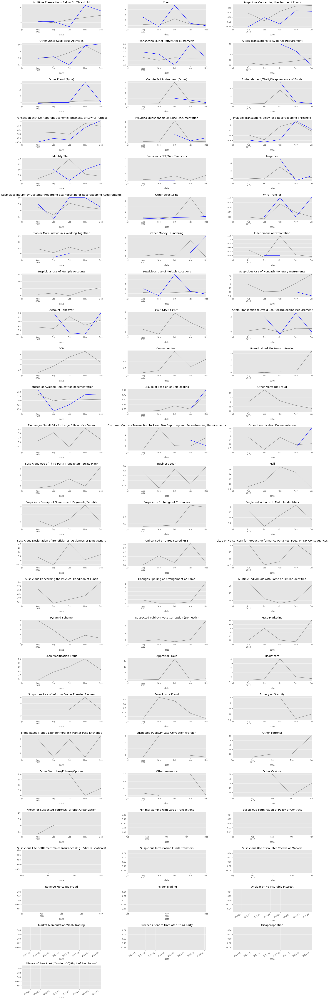

In [127]:
suspiciousplots('06/20/2012', states=['Colorado'])

### 12-month window after:

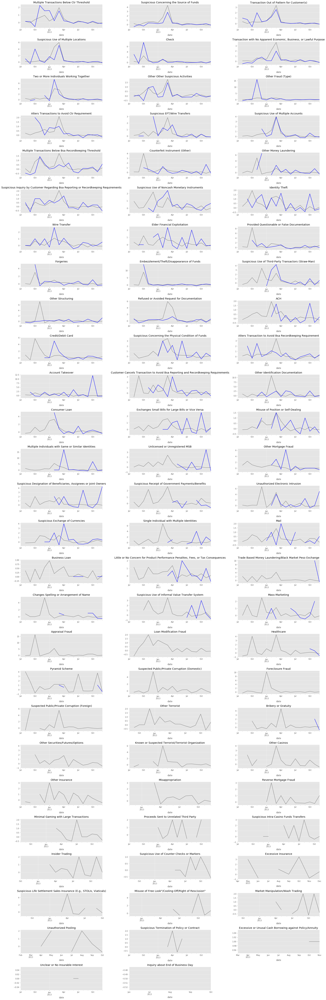

In [114]:
suspiciousplots('06/20/2012', states=['Colorado'], months=12)

# 2012: Hurricane Sandy (Eastern US)

### 6-month window after:

04/27/2013


/Users/rashidakamal/.virtualenvs/work/lib/python3.6/site-packages/matplotlib/axes/_base.py:2917: UserWarning: Attempting to set identical left==right results
in singular transformations; automatically expanding.
left=734988.0, right=734988.0
  'left=%s, right=%s') % (left, right))
/Users/rashidakamal/.virtualenvs/work/lib/python3.6/site-packages/matplotlib/axes/_base.py:2917: UserWarning: Attempting to set identical left==right results
in singular transformations; automatically expanding.
left=734958.0, right=734958.0
  'left=%s, right=%s') % (left, right))
/Users/rashidakamal/.virtualenvs/work/lib/python3.6/site-packages/matplotlib/axes/_base.py:2917: UserWarning: Attempting to set identical left==right results
in singular transformations; automatically expanding.
left=734899.0, right=734899.0
  'left=%s, right=%s') % (left, right))


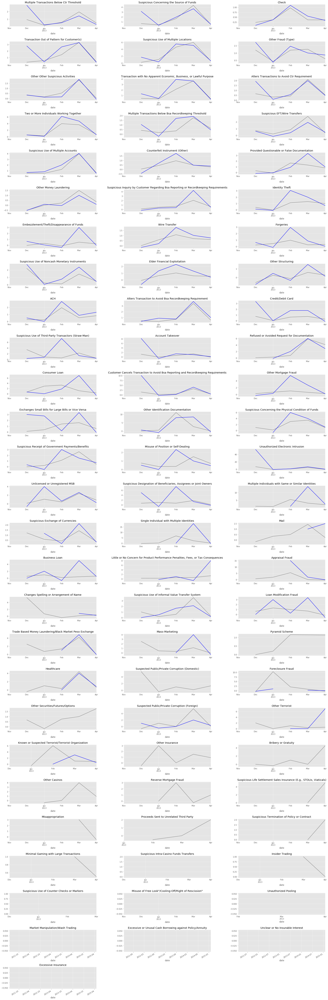

In [129]:
suspiciousplots('10/29/2012', states=['New York', 'New Jersey'])

### 12-month window after:

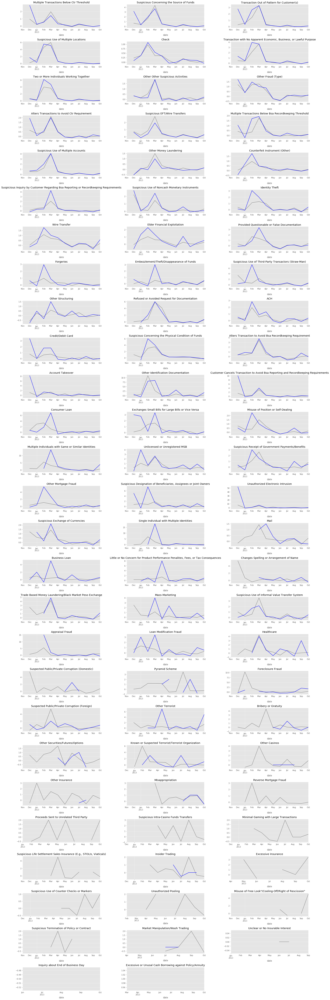

In [132]:
suspiciousplots('10/29/2012', states=['New York', 'New Jersey'], months=12)

# December 14, 2012: Sandy Hook Shooting (Newtown, CT)

### 6-month window after:

/Users/rashidakamal/.virtualenvs/work/lib/python3.6/site-packages/matplotlib/axes/_base.py:2917: UserWarning: Attempting to set identical left==right results
in singular transformations; automatically expanding.
left=735049.0, right=735049.0
  'left=%s, right=%s') % (left, right))
/Users/rashidakamal/.virtualenvs/work/lib/python3.6/site-packages/matplotlib/axes/_base.py:2917: UserWarning: Attempting to set identical left==right results
in singular transformations; automatically expanding.
left=734958.0, right=734958.0
  'left=%s, right=%s') % (left, right))


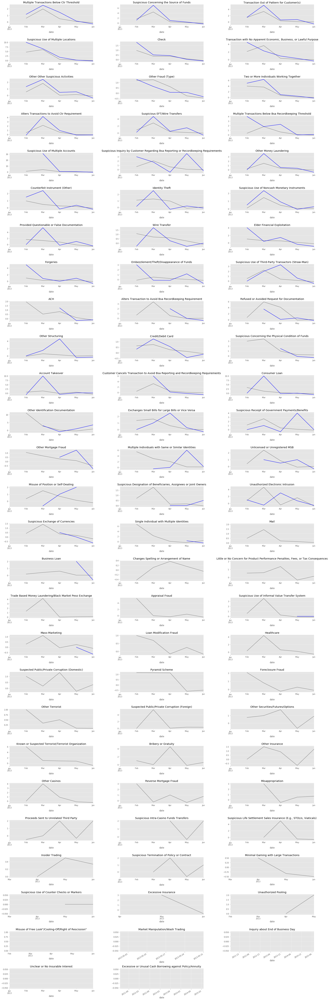

In [133]:
suspiciousplots('12/14/2012', states=['Connecticut'])

### 12-month window after:

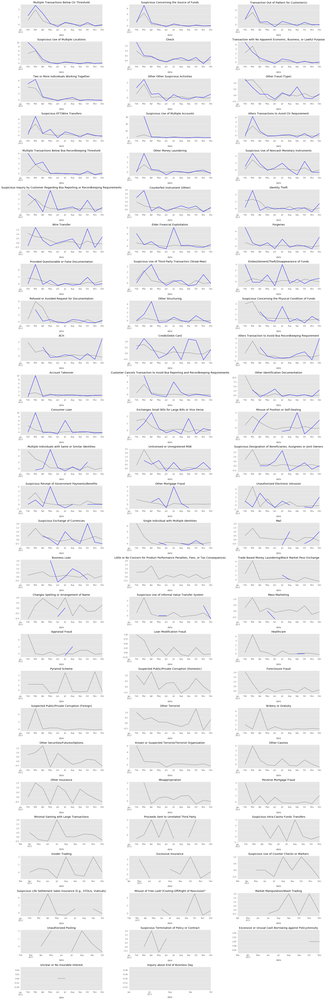

In [134]:
suspiciousplots('12/14/2012', states=['Connecticut'], months=12)

# 2013, February: Nor'easter (Eastern US)

### 6-month window after:

/Users/rashidakamal/.virtualenvs/work/lib/python3.6/site-packages/matplotlib/axes/_base.py:2917: UserWarning: Attempting to set identical left==right results
in singular transformations; automatically expanding.
left=735049.0, right=735049.0
  'left=%s, right=%s') % (left, right))
/Users/rashidakamal/.virtualenvs/work/lib/python3.6/site-packages/matplotlib/axes/_base.py:2917: UserWarning: Attempting to set identical left==right results
in singular transformations; automatically expanding.
left=734958.0, right=734958.0
  'left=%s, right=%s') % (left, right))


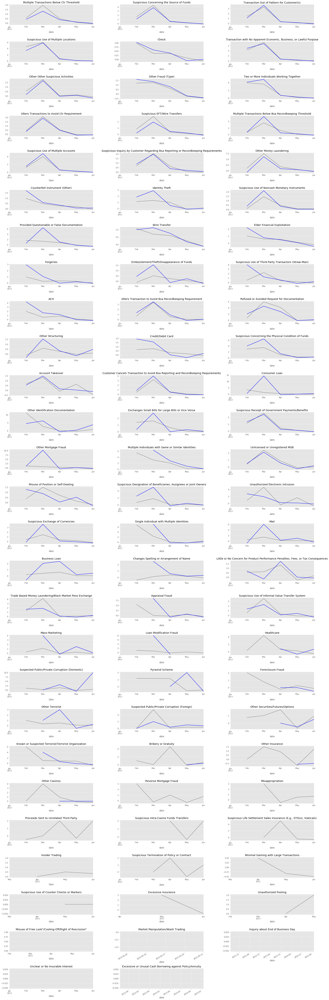

In [135]:
suspiciousplots('12/14/2012', states=['Connecticut', 'Vermont', 'Massachusetts', 'Maine', 'New York', 'Rhode Island'])

### 12-month window after:

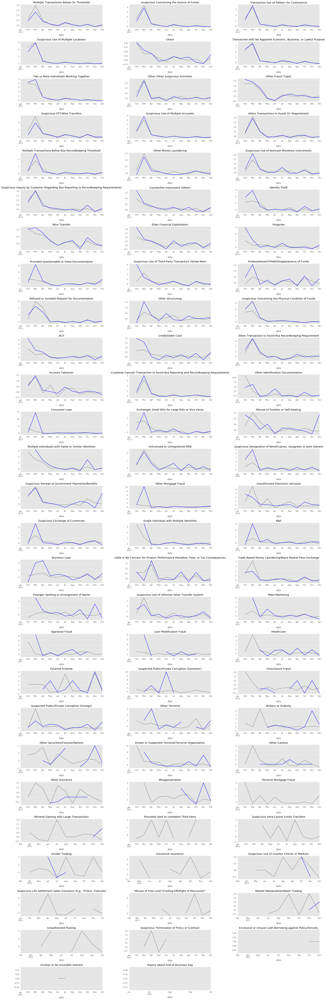

In [136]:
suspiciousplots('12/14/2012', states=['Connecticut', 'Vermont', 'Massachusetts', 'Maine', 'New York', 'Rhode Island'],
               months=12)

Some interesting peaks here. It might be interesting to breakdown which states we look at into smaller groups. 

# 2013: Tornado (Moore, OK)

### 6-month window after:

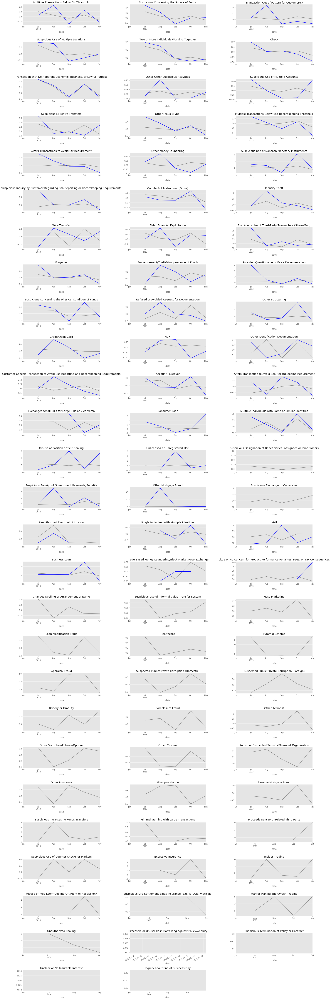

In [137]:
suspiciousplots("05/20/2013", states=['Oklahoma'])

### 12-month window after:

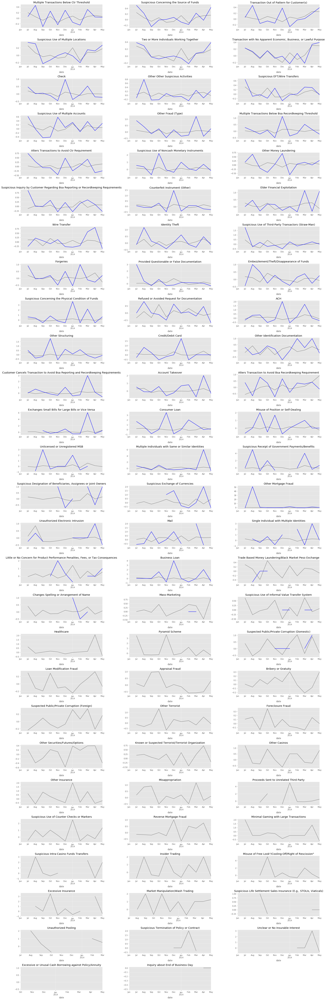

In [138]:
suspiciousplots("05/20/2013", states=['Oklahoma'], months=12)

# 2013: Flood (Colorado)

### 6-month window after:

/Users/rashidakamal/.virtualenvs/work/lib/python3.6/site-packages/matplotlib/axes/_base.py:2917: UserWarning: Attempting to set identical left==right results
in singular transformations; automatically expanding.
left=735172.0, right=735172.0
  'left=%s, right=%s') % (left, right))


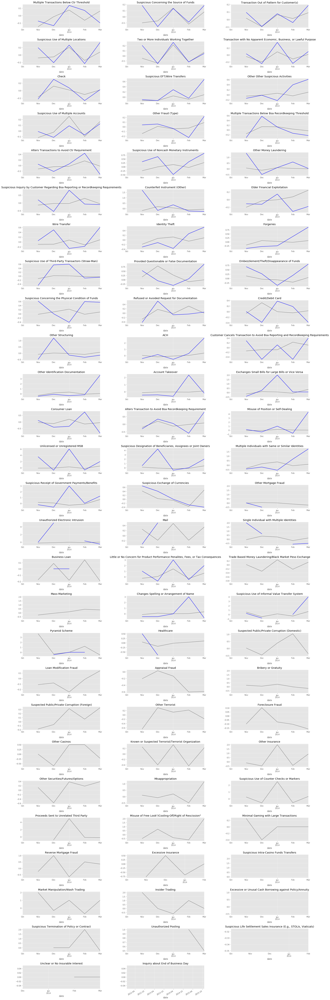

In [139]:
suspiciousplots("09/09/2013", states=['Colorado'])

### 12-month window after:

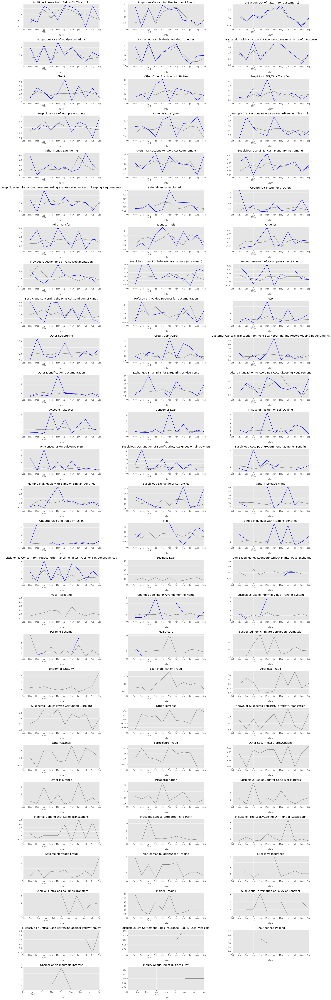

In [140]:
suspiciousplots("09/09/2013", states=['Colorado'], months=12)

# 2014: Wildfire (Yarnell, Arizona)

### 6-month window after:

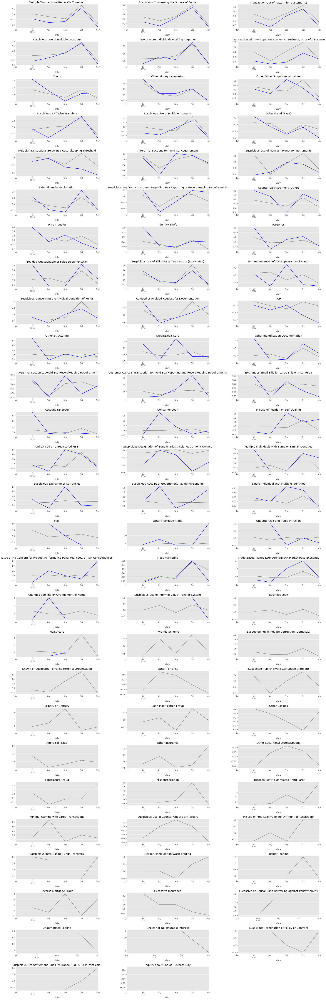

In [141]:
suspiciousplots("05/23/2014", states=['Arizona'])

### 12-month window after:

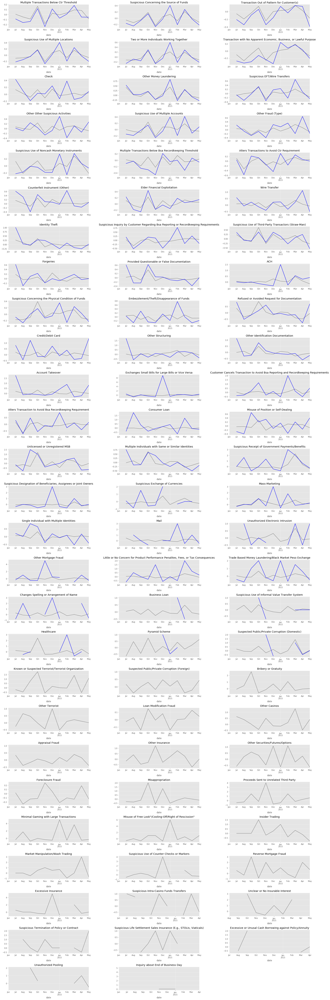

In [142]:
suspiciousplots("05/23/2014", states=['Arizona'], months=12)

# Early 2014: Cold wave (Eastern US)

### 6-month window after:

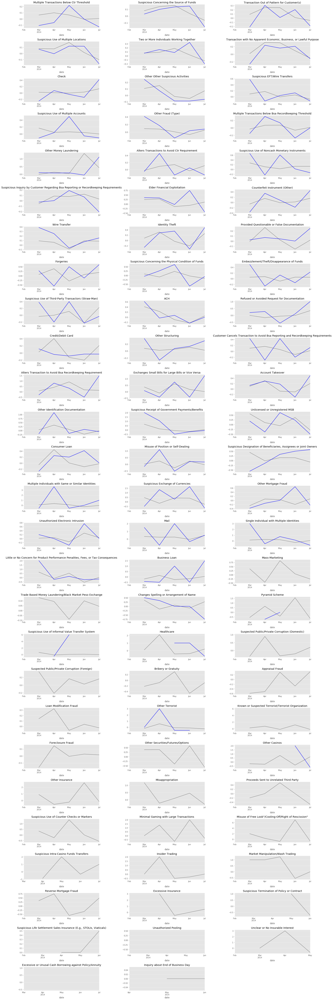

In [143]:
suspiciousplots("01/05/2014", states=['Wisconsin', 'Minnesota'])

### 12-month window after:

In [ ]:
suspiciousplots("01/05/2014", states=['Wisconsin', 'Minnesota'], months=12)

# 2014: Mudflow (Oso, Washington)

### 6-month window after:

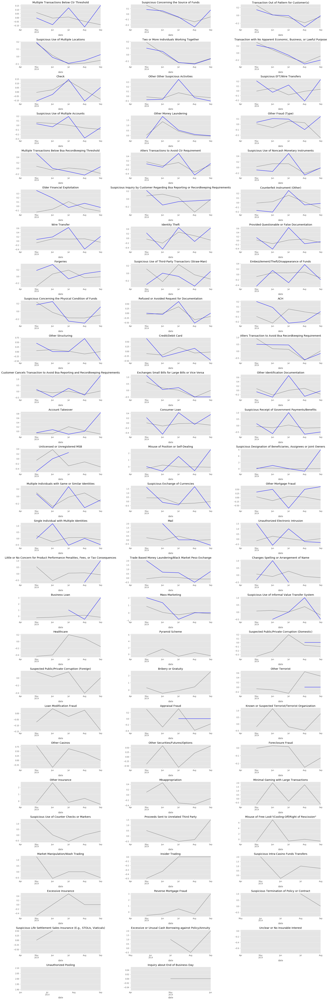

In [144]:
suspiciousplots("03/22/2014", states=['Washington'])

### 12-month window after:

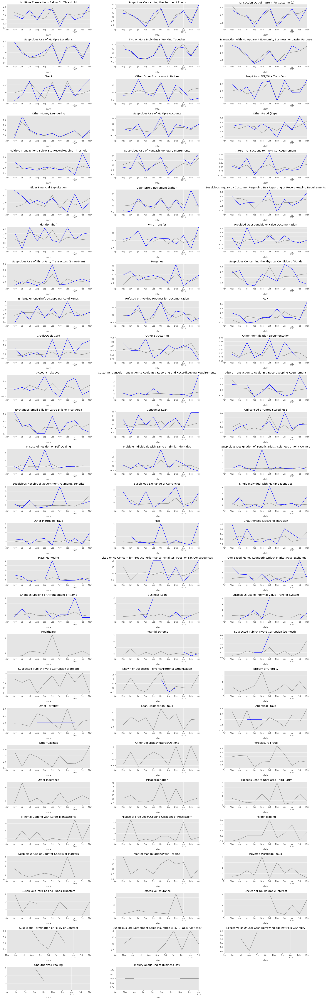

In [145]:
suspiciousplots("03/22/2014", states=['Washington'], months=12)

# 2014, April: Tornado (NE, LA, OK, IL, FL, NC)

### 6-month window after:

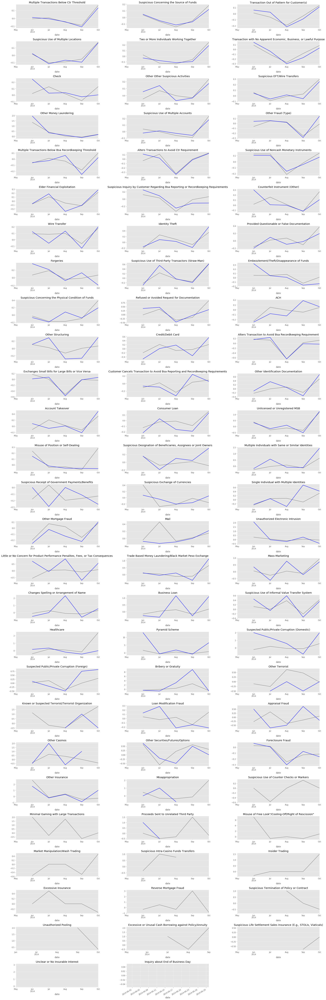

In [146]:
suspiciousplots("04/27/2014", states=['Nebraska', 'Louisiana', 'Oklahoma', 'Illinios','Florida', 'North Carolina'])

### 12-month window after:

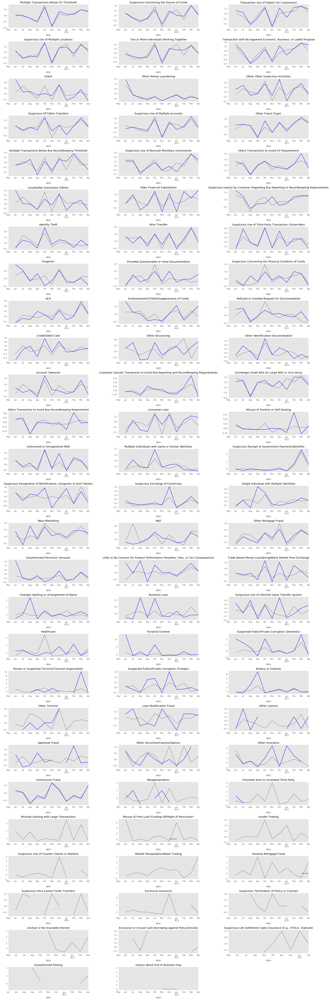

In [147]:
suspiciousplots("04/27/2014", states=['Nebraska', 'Louisiana', 'Oklahoma', 'Illinios','Florida', 'North Carolina'], months=12)

# 2014, November: Snow storm (Buffalo, NY + Great Lakes)

### 6-month window after:

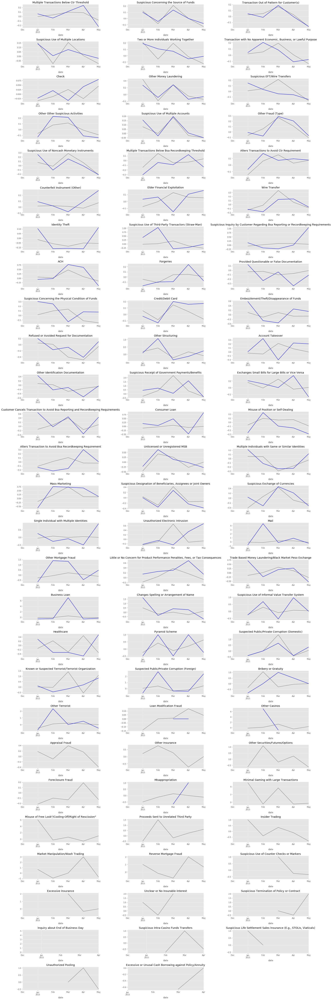

In [148]:
suspiciousplots("11/13/2014", states=['New York'])

### 12-month window after:

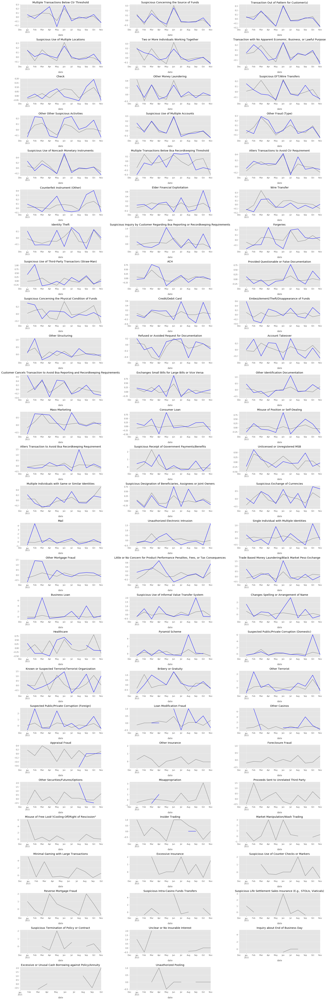

In [150]:
suspiciousplots("11/13/2014", states=['New York'], months=12)

# 2015: Flood (TX, KS, OK)

### 6-month window after:

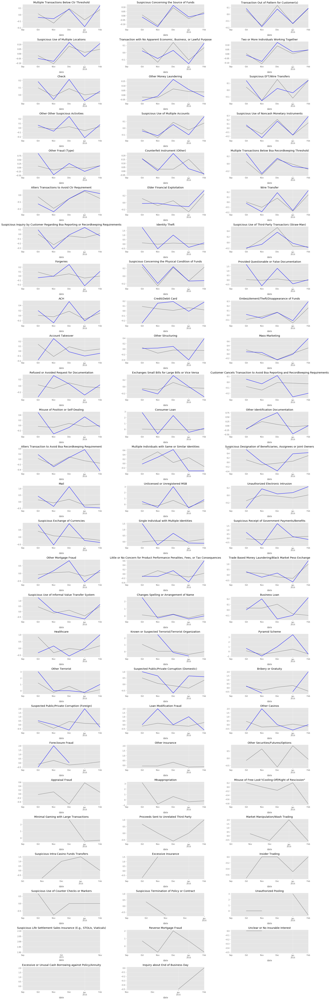

In [149]:
suspiciousplots("08/16/2015", states=['Texas', 'Kansas', 'Oklahoma'])

### 12-month window after:

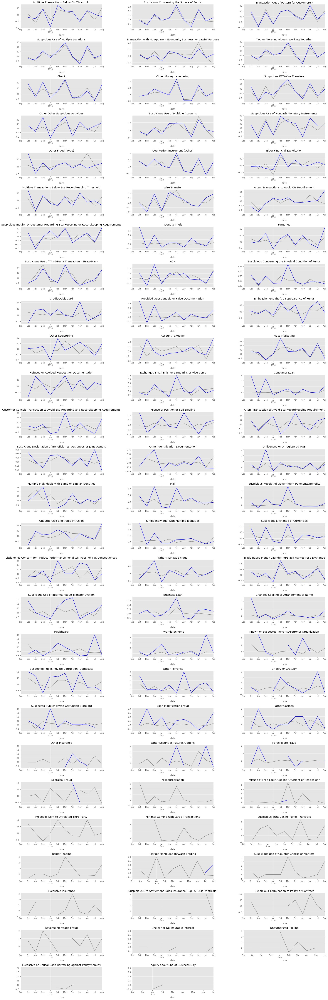

In [152]:
suspiciousplots("08/16/2015", states=['Texas', 'Kansas', 'Oklahoma'], months=12)

# 2015: Wildfire (Okanogan County, Washington)

### 6-month window after:

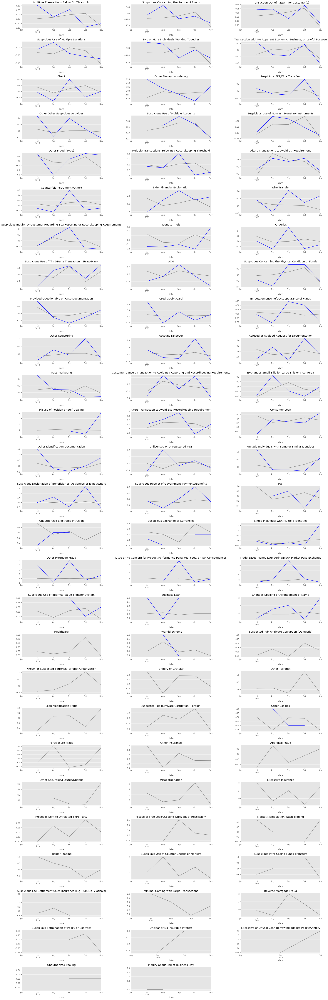

In [151]:
suspiciousplots("06/01/2015", states=['Washington'])

### 12-month window after:

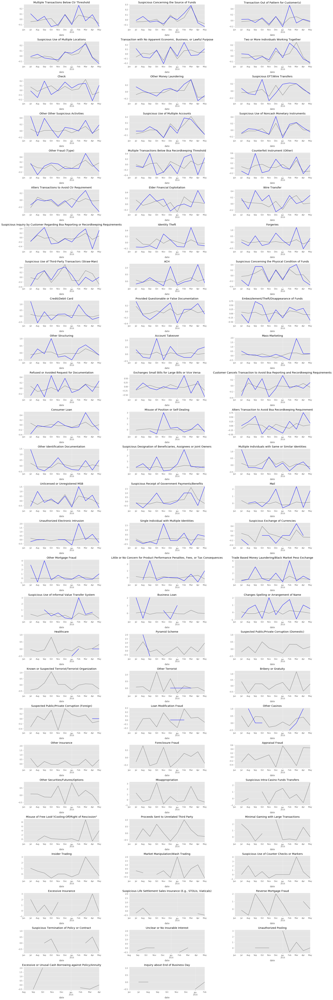

In [153]:
suspiciousplots("06/01/2015", states=['Washington'], months=12)

# 2015: Flood (UT)

### 6-month window after:

/Users/rashidakamal/.virtualenvs/work/lib/python3.6/site-packages/matplotlib/axes/_base.py:2917: UserWarning: Attempting to set identical left==right results
in singular transformations; automatically expanding.
left=735932.0, right=735932.0
  'left=%s, right=%s') % (left, right))


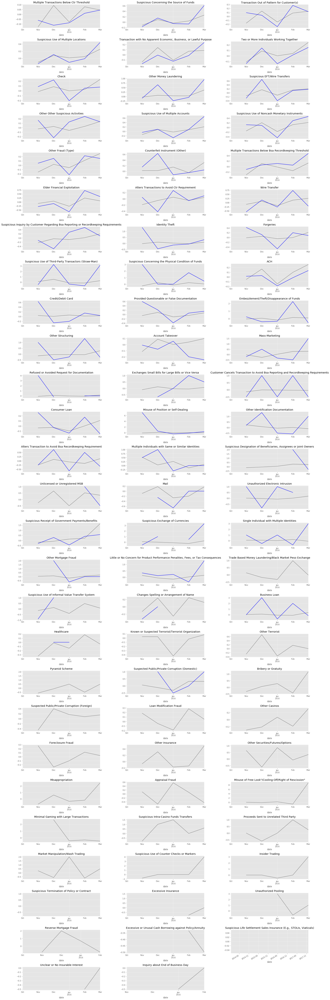

In [154]:
suspiciousplots("09/16/2015", states=['Utah'])

### 12-month window after:

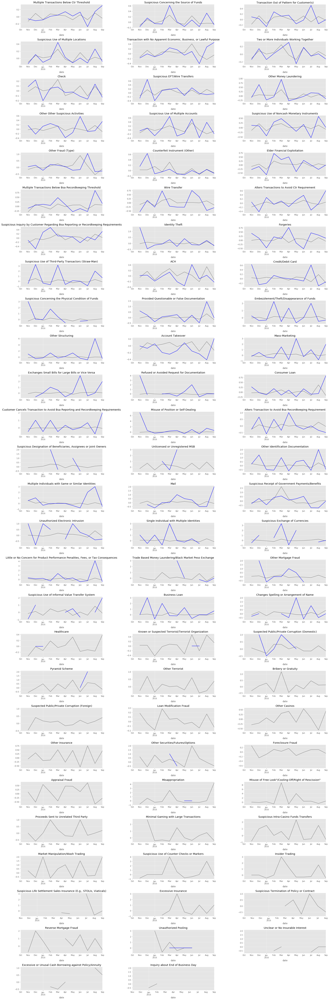

In [155]:
suspiciousplots("09/16/2015", states=['Utah'], months=12)

# 2015, October: Flood (Carolinas)

### 6-month window after:

In [ ]:
suspiciousplots("09/29/2015", states=['North Carolina', 'South Carolina'])

### 12-month window after:

In [ ]:
suspiciousplots("09/29/2015", states=['North Carolina', 'South Carolina'], months=12)

# 2016, January: Blizzard (Eastern US)

### 6-month window after:

### 12-month window after:

# 2016: Flood (WV)

### 6-month window after:

### 12-month window after:

# 2016: Flood (LA)

### 6-month window after:

### 12-month window after:

# 2016: Hurricane Matthew (FL, GA, Carolinas)

### 6-month window after:

### 12-month window after:

# 2016: Wildfire (Smoky Mountains, TN)

### 6-month window after:

### 12-month window after:

# 2017: Hurricane Harvey (TX, LA, AL)

### 6-month window after:

# 2017: Hurricane Irma (FL, SC, GA, PR)

### 6-month window after: